# DSC-680 Applied Data Science
## Project #2 -  Airbnb Recommendation Engine

By Ambrose M Malagon Cordero
___________

**Data Sets**

The following data sets were acquired from http://insideairbnb.com/get-the-data.html:

1. listings.csv.gz - Detailed Listings in Broward County with a total of 74 features. 

2. reviews_en.csv.gz – Detailed reviews for listings in Broward County, filtered to only use English language reviews. 

Both datasets are available in this GibHut repository for replication purposes. Please check the Project documentation PDF for full details regarding these files.


_____________________
## Data Preparation

In [157]:
# Libraries and dependencies used for this project

import gzip     #To open gzip files.
import pandas as pd     #For Data Frames and associated functionality
import nltk     # For text/sentiment analysis
from nltk.sentiment import SentimentIntensityAnalyzer       # Sentiment analysis dependencies
import matplotlib.pyplot as plt         # For visualizations
import seaborn as sns       # For additonal visualization functionality 
from yellowbrick.features import Rank2D     # Generates Pearson's ranking
from sklearn import preprocessing       #
from surprise import Reader, Dataset, SVD
from surprise.model_selection.validation import cross_validate
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity

In [2]:
# Function - Opens gzip file and appends it to a data frame.
def get_data(file_path):
    with gzip.open(file_path) as f:
        data = pd.read_csv(f)
    return data

In [3]:
# Opens listing and reviews data
listings = get_data('listings.csv.gz')
reviews = get_data('reviews_en.csv.gz')

/Users/ambrosemmalagon-cordero/anaconda3/envs/new_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3337: DtypeWarning: Columns (67) have mixed types.Specify dtype option on import or set low_memory=False.
  if (await self.run_code(code, result,  async_=asy)):


In [4]:
# Pre-select listings fields
listings_ = listings[['property_type','amenities','price','availability_365','accommodates','number_of_reviews_l30d', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value']]

In [5]:
# Initiate the Sentiment Analysis
sia = SentimentIntensityAnalyzer()

In [6]:
# Function - Gets the Compound Polarity Score for text
def get_cs(row):
    return sia.polarity_scores(row['comments_r'])['compound']

In [7]:
# Get the Compound Polarity Score
reviews['sc_comp'] = reviews.apply(get_cs, axis=1)

In [8]:
# Convert date
reviews['date'] = pd.to_datetime(reviews['date'], format='%Y-%m-%d')

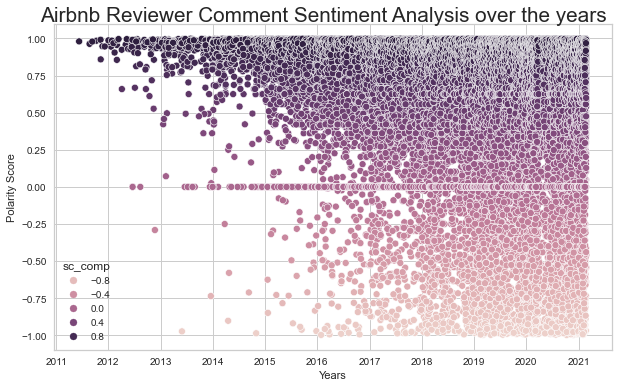

In [9]:
# Scatter Plot
plt.rcParams['figure.figsize'] = (10, 6)
sns.scatterplot(x="date", y="sc_comp", data=reviews, hue="sc_comp")
sns.color_palette("mako", as_cmap=True)
plt.xlabel("Years")
plt.ylabel("Polarity Score")
plt.suptitle('Airbnb Reviewer Comment Sentiment Analysis over the years', x=0.5, y= 0.92, ha='center', fontsize='xx-large')
plt.savefig('sc_1.png')

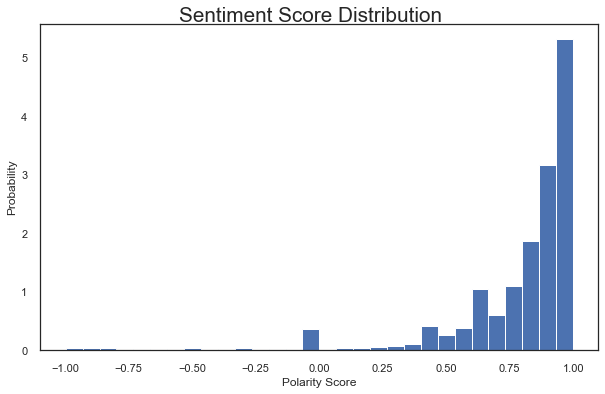

In [10]:
# Histogram #1
sns.set_theme(style="white")
plt.rcParams['figure.figsize'] = (10, 6)
plt.hist(reviews['sc_comp'], bins=30, density=True)
plt.ylabel('Probability')
plt.xlabel('Polarity Score')
plt.suptitle('Sentiment Score Distribution', x=0.5, y= 0.92, ha='center', fontsize='xx-large')
plt.savefig('hist_1.png')

In [11]:
# Prepare data for stats
stats = reviews[['listing_id','sc_comp']].groupby(['listing_id']).agg(['mean', 'count']).reset_index()
mi = stats.columns.to_flat_index()
mi = mi.tolist()
ind = pd.Index([e[0] + e[1] for e in mi])
stats.columns = ind

In [12]:
# More stats for fact finding
ver = stats[['sc_compcount','listing_id']].groupby(['sc_compcount']).agg(['count']).reset_index()
mi = ver.columns.to_flat_index()
mi = mi.tolist()
ind = pd.Index([e[0] + '_' +e[1] for e in mi])
ver.columns = ind

In [13]:
# Filter out records with less than 100 reviews
ver_ = ver[ver.sc_compcount_<100]

In [16]:
# Review Data
ver_

,sc_compcount_,listing_id_count
0,1,1062
1,2,656
2,3,516
3,4,402
4,5,308
...,...,...
94,95,7
95,96,14
96,97,14
97,98,4


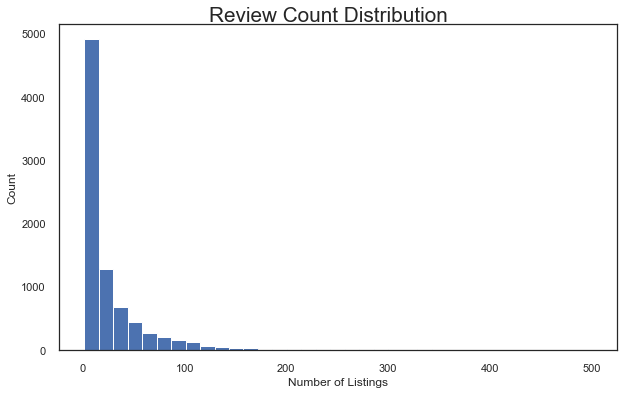

In [15]:
# Histogram #2
sns.set_theme(style="white")
plt.rcParams['figure.figsize'] = (10, 6)
plt.hist(stats['sc_compcount'], bins=35)
plt.ylabel('Count')
plt.xlabel('Number of Listings')
plt.suptitle('Review Count Distribution', x=0.5, y= 0.92, ha='center', fontsize='xx-large')
plt.savefig('p_2.png')

In [28]:
# Filter data with less than 100 reviews
stats_ = stats[['listing_id', 'sc_compcount']]
reviews_s = pd.merge(stats_,reviews, on='listing_id', how='left')
reviews_s1 = reviews_s[reviews_s.sc_compcount > 100]
listings_1 = listings[listings.id.isin(list(reviews_s1.listing_id.unique()))]
reviews_s2 = reviews_s1[['listing_id','sc_comp']].groupby(['listing_id']).mean().reset_index()
listings_2 = pd.merge(listings_1, reviews_s2, right_on='listing_id', left_on='id', how='left')

In [32]:
listings_2.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [33]:
# Select features
listings_3 = listings_2[['property_type','amenities','price','availability_365','accommodates','number_of_reviews_l30d', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value','sc_comp']]

In [34]:
# Pearson's Ranking
feature = ['price','availability_365','accommodates','number_of_reviews_l30d','price','availability_365','number_of_reviews_l30d', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value']
target = 'sc_comp'
X = listings_3[feature]
y = listings_3[target]

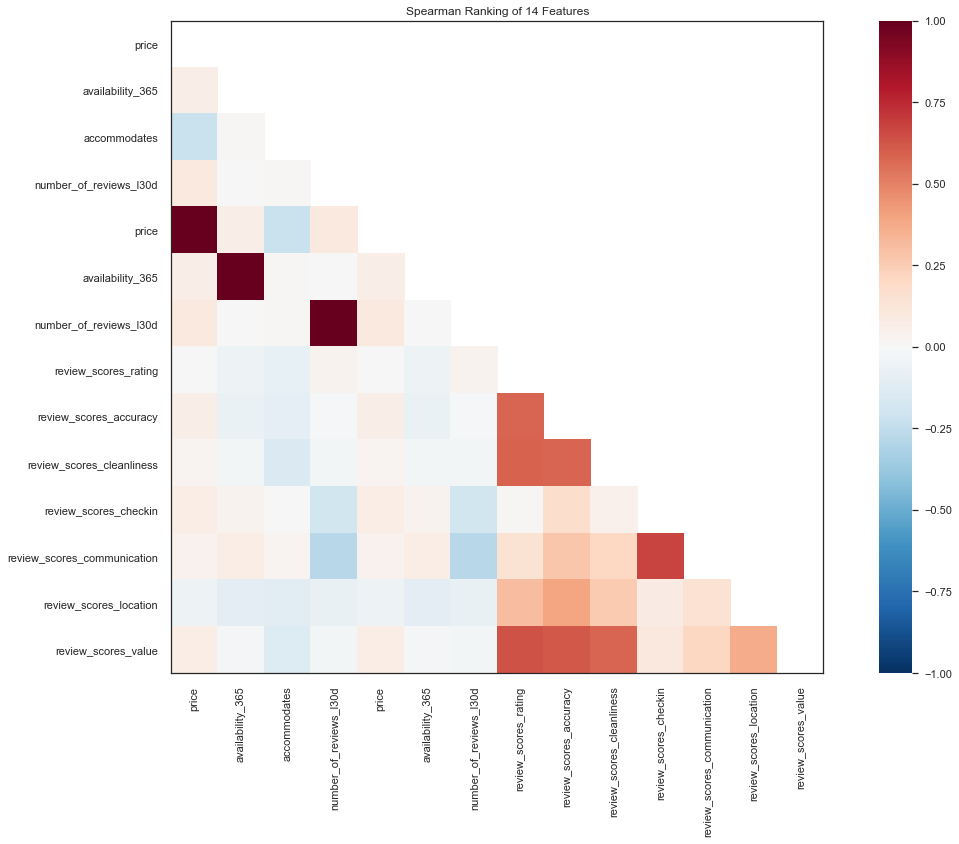

<AxesSubplot:title={'center':'Spearman Ranking of 14 Features'}>

In [35]:
plt.rcParams['figure.figsize'] = (20, 12)
visualizer = Rank2D(features=feature, algorithm='spearman')
visualizer.fit(X, y)                 
visualizer.transform(X)             
visualizer.poof()

## Cross Validation - KNN

In [36]:
reader = Reader()
data = Dataset.load_from_df(reviews_s1[['reviewer_id', 'listing_id', 'sc_comp']], reader)
svd = SVD()
cross_validate(svd, data, measures=['RMSE', 'MAE'], cv=10, verbose=True)

Evaluating RMSE, MAE of algorithm SVD on 10 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Fold 6  Fold 7  Fold 8  Fold 9  Fold 10 Mean    Std     
RMSE (testset)    0.3040  0.3052  0.3065  0.3225  0.3212  0.3091  0.3125  0.3094  0.3119  0.3248  0.3127  0.0071  
MAE (testset)     0.1884  0.1879  0.1895  0.1946  0.1948  0.1899  0.1902  0.1897  0.1920  0.1950  0.1912  0.0026  
Fit time          3.57    3.44    3.57    3.55    3.51    3.46    3.70    4.17    4.06    4.04    3.71    0.26    
Test time         0.07    0.04    0.04    0.04    0.04    0.04    0.04    0.20    0.04    0.04    0.06    0.05    


{'test_rmse': array([0.30404367, 0.30521131, 0.30651231, 0.32249725, 0.32121146,
        0.30909973, 0.3125099 , 0.30935206, 0.31190391, 0.32476376]),
 'test_mae': array([0.18839978, 0.18791051, 0.18949095, 0.19456665, 0.19475602,
        0.18988074, 0.19020313, 0.18970475, 0.19201669, 0.19500582]),
 'fit_time': (3.5693318843841553,
  3.4402451515197754,
  3.5681159496307373,
  3.5488247871398926,
  3.5061309337615967,
  3.4644320011138916,
  3.696814775466919,
  4.168287038803101,
  4.062623977661133,
  4.042788028717041),
 'test_time': (0.06998085975646973,
  0.03880000114440918,
  0.038931846618652344,
  0.03900313377380371,
  0.039891958236694336,
  0.04036283493041992,
  0.039433956146240234,
  0.1980881690979004,
  0.044033050537109375,
  0.044310808181762695)}

In [37]:
trainset = data.build_full_trainset()
svd.fit(trainset)

In [38]:
reviews_s1['Estimate_Score'] = reviews_s1['listing_id'].apply(lambda x: svd.predict(545166, x).est)

/Users/ambrosemmalagon-cordero/anaconda3/envs/new_env/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [39]:
# Review results.
reviews_s1.Estimate_Score.unique()

array([1.        , 1.04275562, 1.04069242, 1.01547303, 1.00530093])

## Cosine Similarity

In [108]:
reviews_rev = reviews_s1[['id','reviewer_name','listing_id','comments_r','sc_comp']]

In [114]:
list_d =listings[['id','host_verifications','amenities','property_type','room_type','bathrooms_text','neighbourhood_cleansed']]
list_d = list_d.fillna('')

In [115]:
def combined_features(row):
    for ch in ['[',']',"\\"]:
        if ch in row['host_verifications']:
            row['host_verifications'] = row['host_verifications'].replace(ch,'')
    for ch in ['[',']',"\\"]:
        if ch in row['amenities']:
            row['amenities'] = row['amenities'].replace(ch,'')
    return row['host_verifications'] + row['amenities']+" "+row['property_type']+" "+row['room_type']+" "+row['bathrooms_text']+" "+row['neighbourhood_cleansed']
#row['host_verifications'] +" "+ row['amenities']+" "+row['property_type']+" "+row['room_type']+" "+row['bathrooms_text']+" "+row['neighbourhood_cleansed']

list_d["combined_features"] = list_d.apply(combined_features, axis =1)

In [116]:
list_d1 = list_d[['id','combined_features']]

In [133]:
list_d1 = list_d1.reset_index()

In [121]:
reviews_feat = pd.merge(reviews_rev, list_d1, left_on='listing_id', right_on='id', how='left')

In [122]:
reviews_feat = reviews_feat[['id_x','reviewer_name','listing_id','comments_r','combined_features','sc_comp']]

In [104]:
cv = CountVectorizer(max_features=5000)
count_matrix = cv.fit_transform(list_d1["combined_features"])
print("Count Matrix:", count_matrix.toarray())

Count Matrix: [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [139]:
cosine_sim = cosine_similarity(count_matrix)

In [137]:
properties_like = 48282214

def get_index_from_id(id):
    return list_d1[list_d1.id == id]["index"].values[0]

property_index = get_index_from_id(properties_like)

In [129]:
reviews_feat = reviews_feat.reset_index()

In [134]:
list_d1[list_d1.index == list_d1]

,index,id,combined_features
0,0,57818,"'email', 'phone', 'facebook', 'reviews', 'jumi..."
1,1,69824,"'email', 'phone', 'facebook', 'kba'""Smart lock..."
2,2,83449,"'email', 'phone', 'facebook', 'reviews'""Hair d..."
3,3,105411,"'email', 'phone', 'facebook', 'reviews', 'jumi..."
4,4,129061,"'email', 'phone', 'manual_online', 'facebook',..."
...,...,...,...
11125,11125,48282214,"'email', 'phone', 'jumio', 'offline_government..."
11126,11126,48282227,"'email', 'phone', 'jumio', 'offline_government..."
11127,11127,48283295,"'phone', 'offline_government_id', 'selfie', 'g..."
11128,11128,48283618,"'email', 'phone', 'jumio', 'offline_government..."


In [146]:
similar_properties = list(enumerate(cosine_sim[property_index]))

In [147]:
sorted_similar_properties = sorted(similar_properties, key=lambda x:x[1], reverse=True)

In [148]:
sorted_similar_movies[0:10]

[(11125, 0.9999999999999991),
 (10586, 0.9682905995410156),
 (10511, 0.8524367141602651),
 (1772, 0.8510081676916115),
 (10507, 0.8461141122266491),
 (11091, 0.8461141122266491),
 (294, 0.8274095004781383),
 (106, 0.8114822249196504),
 (854, 0.8067793113007149),
 (1771, 0.8035714285714284)]

In [149]:
def get_id_from_index(index):
    return list_d1[list_d1.index == index]["id"].values[0]

In [150]:
i=0
for p in sorted_similar_properties:
    print(get_id_from_index(p[0]))
    i=i+1
    if i>15:
        break

48282214
47782654
47740729
18323574
47733681
48252415
4908694
1717935
11355413
18314203
17210968
45207723
15790665
21121671
16733804
11048955


In [156]:
list_d[list_d.id.isin([48282214,47782654,47740729,18323574,47733681,48252415,4908694,1717935])].to_csv('results_2.csv')